## No Show Appointments Dataset Exploration and Preparation

This notebook purpose is to prepare and explore dataset of patients no show appointments. The dataset is from Kaggle and can be found here: https://www.kaggle.com/joniarroba/noshowappointments

### Import libraries

In [2]:
import polars as pl
import plotly.express as px
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


sns.set_theme(style="whitegrid")

### Load dataset using Polars

In [173]:
dtypes = {
    "PatientId": pl.Utf8,
    "AppointmentID": pl.UInt32,
    "Gender": pl.Utf8,
    "ScheduledDay": pl.Utf8,
    "AppointmentDay": pl.Utf8,
    "Age": pl.UInt8,
    "Neighbourhood": pl.Utf8,
    "Scholarship": pl.UInt8,
    "Hipertension": pl.UInt8,
    "Diabetes": pl.UInt8,
    "Alcoholism": pl.UInt8,
    "Handcap": pl.UInt8,
    "SMS_received": pl.UInt8,
    "No-show": pl.Utf8,
}

%time
df = pl.read_csv("data/KaggleV2-May-2016.csv", dtypes=dtypes)

CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 3.1 µs


### Inspect dataset

In [174]:
df.head(5)

PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
str,u32,str,str,str,u8,str,u8,u8,u8,u8,u8,u8,str
"""29872499824296…",5642903,"""F""","""2016-04-29T18:…","""2016-04-29T00:…",62,"""JARDIM DA PENH…",0,1,0,0,0,0,"""No"""
"""55899777669443…",5642503,"""M""","""2016-04-29T16:…","""2016-04-29T00:…",56,"""JARDIM DA PENH…",0,0,0,0,0,0,"""No"""
"""4262962299951""",5642549,"""F""","""2016-04-29T16:…","""2016-04-29T00:…",62,"""MATA DA PRAIA""",0,0,0,0,0,0,"""No"""
"""867951213174""",5642828,"""F""","""2016-04-29T17:…","""2016-04-29T00:…",8,"""PONTAL DE CAMB…",0,0,0,0,0,0,"""No"""
"""8841186448183""",5642494,"""F""","""2016-04-29T16:…","""2016-04-29T00:…",56,"""JARDIM DA PENH…",0,1,1,0,0,0,"""No"""


In [175]:
df.tail(5)

PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
str,u32,str,str,str,u8,str,u8,u8,u8,u8,u8,u8,str
"""2572134369293""",5651768,"""F""","""2016-05-03T09:…","""2016-06-07T00:…",56,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""3596266328735""",5650093,"""F""","""2016-05-03T07:…","""2016-06-07T00:…",51,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""15576631729893…",5630692,"""F""","""2016-04-27T16:…","""2016-06-07T00:…",21,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""92134931435557…",5630323,"""F""","""2016-04-27T15:…","""2016-06-07T00:…",38,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""37751151812112…",5629448,"""F""","""2016-04-27T13:…","""2016-06-07T00:…",54,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""


In [176]:
df.columns

['PatientId',
 'AppointmentID',
 'Gender',
 'ScheduledDay',
 'AppointmentDay',
 'Age',
 'Neighbourhood',
 'Scholarship',
 'Hipertension',
 'Diabetes',
 'Alcoholism',
 'Handcap',
 'SMS_received',
 'No-show']

In [177]:
df.shape

(110527, 14)

The dataset contains 110527 rows and 14 columns associated with 110527 medical appointments in Brazil and is focused on the question of whether or not patients show up for their appointment. A number of characteristics about the patient are included in each row.

### Load dataset using Pandas

In [3]:
%time
df = pd.read_csv("data/KaggleV2-May-2016.csv")

CPU times: user 1 µs, sys: 1 µs, total: 2 µs
Wall time: 3.1 µs


In [4]:
from collections import Counter


print(Counter(df["No-show"]))

Counter({'No': 88208, 'Yes': 22319})


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   PatientId       110527 non-null  float64
 1   AppointmentID   110527 non-null  int64  
 2   Gender          110527 non-null  object 
 3   ScheduledDay    110527 non-null  object 
 4   AppointmentDay  110527 non-null  object 
 5   Age             110527 non-null  int64  
 6   Neighbourhood   110527 non-null  object 
 7   Scholarship     110527 non-null  int64  
 8   Hipertension    110527 non-null  int64  
 9   Diabetes        110527 non-null  int64  
 10  Alcoholism      110527 non-null  int64  
 11  Handcap         110527 non-null  int64  
 12  SMS_received    110527 non-null  int64  
 13  No-show         110527 non-null  object 
dtypes: float64(1), int64(8), object(5)
memory usage: 11.8+ MB


### Visualize and inspect dataset features

#### SMS received and no show

In [6]:
# check sms received and no-show

df.groupby(["SMS_received", "No-show"]).size()

SMS_received  No-show
0             No         62510
              Yes        12535
1             No         25698
              Yes         9784
dtype: int64

#### Age

In [135]:
fig = px.histogram(df, x=df['Age'], nbins=50)
fig.update_xaxes(title_text='Age')
fig.show()

In [124]:
print(f"Number of unique values in Age: {df['Age'].nunique()}")
print(f"Age range: ({df['Age'].min()} - {df['Age'].max()})")
print(f"Mean age: {round(df['Age'].mean(), 2)}")
print(f"Median age: {df['Age'].median()}")
print(f"Standard deviation: {round(df['Age'].std(), 2)}")

Number of unique values in Age: 104
Age range: (-1 - 115)
Mean age: 37.09
Median age: 37.0
Standard deviation: 23.11


In [125]:
df[df['Age'] == -1]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


In [184]:
df[df['Age'] == 115]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
63912,3.196321e+13,5700278,F,2016-05-16T09:17:44Z,2016-05-19T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,Yes
63915,3.196321e+13,5700279,F,2016-05-16T09:17:44Z,2016-05-19T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,Yes
68127,3.196321e+13,5562812,F,2016-04-08T14:29:17Z,2016-05-16T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,Yes
76284,3.196321e+13,5744037,F,2016-05-30T09:44:51Z,2016-05-30T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,No
97666,7.482346e+14,5717451,F,2016-05-19T07:57:56Z,2016-06-03T00:00:00Z,115,SÃO JOSÉ,0,1,0,0,0,1,No


Analyzing the age distribution of the patients, it can be seen that the majority of the patients are within age range of 0-50 years old. The distribution is right skewed.

In [185]:
fig = px.histogram(df, x=df['Gender'])
fig.update_xaxes(title_text='Gender')
fig.show()

The number of females is higher than the number of males in the dataset. This may indicate that women take greater care of their health.

#### Scholarship

In [186]:
fig = px.pie(df, values=df['Scholarship'].value_counts(), names=df['Scholarship'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Scholarship')

The number of patients who are enrolled in Brasilian welfare program Bolsa Família is higher than the number of patients who are not enrolled in the program.

In [187]:
# print unique values in Scholarship
print(f"Unique values in Scholarship: {df['Scholarship'].unique()}")

Unique values in Scholarship: [0 1]


#### Neighbourhood 

In [188]:
fig = px.histogram(df, x=df['Neighbourhood'])
fig.update_xaxes(title_text='Neighbourhood')
fig.show()

In [189]:
# print the number of unique values in Neighbourhood
print(f"Number of unique values in Neighbourhood: {df['Neighbourhood'].nunique()}")

Number of unique values in Neighbourhood: 81


Jardim Camburi is the neighborhood with the highest number of appointments.

#### Handicap


In [190]:
fig = px.histogram(df, x=df['Handcap'])
fig.update_xaxes(title_text='Handcap')
fig.show()

In [191]:
# print unique values in Handcap and the number of values
print(f"Unique values in Handcap: {df['Handcap'].unique()}")
print(f"Number of values in Handcap:\n{df['Handcap'].value_counts()}")

Unique values in Handcap: [0 1 2 3 4]
Number of values in Handcap:
0    108286
1      2042
2       183
3        13
4         3
Name: Handcap, dtype: int64


The number of patients who are not handicapped is higher than the number of patients who are handicapped.

#### Hipertension

In [192]:
# add pie chart for Hipertension
fig = px.pie(df, values=df['Hipertension'].value_counts(), names=df['Hipertension'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Hipertension')
fig.show()

The patients who are not hypertensive are more than the patients who are hypertensive.

In [193]:
px.histogram(df, x='Hipertension', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### Diabetes

In [194]:
# add pie chart for Diabetes
fig = px.pie(df, values=df['Diabetes'].value_counts(), names=df['Diabetes'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Diabetes')
fig.show()

In [195]:
px.histogram(df, x='Diabetes', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### Alcoholism

In [196]:
# add pie chart for Alcoholism
fig = px.pie(df, values=df['Alcoholism'].value_counts(), names=df['Alcoholism'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Alcoholism')

In [197]:
px.histogram(df, x='Alcoholism', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### SMS_received

In [198]:
fig = px.pie(df, values=df['SMS_received'].value_counts(), names=df['SMS_received'].unique())
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='SMS_received')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.show()

In [199]:
px.histogram(df, x='SMS_received', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### Patient ID


In [200]:
print(f"Patient ID range: ({df['PatientId'].min()} - {df['PatientId'].max()})")
print(f"Number of unique values in PatientId: {df['PatientId'].nunique()}")

Patient ID range: (39217.84439 - 999981631772427.0)
Number of unique values in PatientId: 62299


#### Appointment ID

In [201]:
print(f"Appointment ID range: ({df['AppointmentID'].min()} - {df['AppointmentID'].max()})")
print(f"Number of unique values in AppointmentID: {df['AppointmentID'].nunique()}")

Appointment ID range: (5030230 - 5790484)
Number of unique values in AppointmentID: 110527


***
#### Target variable - No Show

The target variable is No Show. It is a binary variable with values of Yes and No.

In [202]:
fig = px.histogram(df, x=df['No-show'])
fig.update_xaxes(title_text='No-show')
fig.show()

In [203]:
fig = px.pie(df, values=df['No-show'].value_counts(), names=df['No-show'].unique())
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_layout(title_text='No-show')
fig.show()


As can be seen in the above figure, the distribution of the target variable is not balanced. Data is imbalanced.

In [204]:
px.histogram(df, x='No-show', color='Gender', barmode='group',
             color_discrete_sequence = px.colors.qualitative.Alphabet)

### Verify validity of data

In [205]:
df.isnull().sum()

PatientId         0
AppointmentID     0
Gender            0
ScheduledDay      0
AppointmentDay    0
Age               0
Neighbourhood     0
Scholarship       0
Hipertension      0
Diabetes          0
Alcoholism        0
Handcap           0
SMS_received      0
No-show           0
dtype: int64

There are no missing values in the dataset.

In [207]:
df.nunique()

PatientId          62299
AppointmentID     110527
Gender                 2
ScheduledDay      103549
AppointmentDay        27
Age                  104
Neighbourhood         81
Scholarship            2
Hipertension           2
Diabetes               2
Alcoholism             2
Handcap                5
SMS_received           2
No-show                2
dtype: int64

In [208]:
df.duplicated().sum()

0

The number of unique values in 110527 rows is equal to the number of rows, which means that there are no duplicate rows in the dataset.

#### Check for invalid values

In [209]:
for col in df.columns:
    if col not in ['PatientId', 'AppointmentID', 'ScheduledDay', 'AppointmentDay']:
        print(f"{col}: {df[col].unique()}")

Gender: ['F' 'M']
Age: [ 62  56   8  76  23  39  21  19  30  29  22  28  54  15  50  40  46   4
  13  65  45  51  32  12  61  38  79  18  63  64  85  59  55  71  49  78
  31  58  27   6   2  11   7   0   3   1  69  68  60  67  36  10  35  20
  26  34  33  16  42   5  47  17  41  44  37  24  66  77  81  70  53  75
  73  52  74  43  89  57  14   9  48  83  72  25  80  87  88  84  82  90
  94  86  91  98  92  96  93  95  97 102 115 100  99  -1]
Neighbourhood: ['JARDIM DA PENHA' 'MATA DA PRAIA' 'PONTAL DE CAMBURI' 'REPÚBLICA'
 'GOIABEIRAS' 'ANDORINHAS' 'CONQUISTA' 'NOVA PALESTINA' 'DA PENHA'
 'TABUAZEIRO' 'BENTO FERREIRA' 'SÃO PEDRO' 'SANTA MARTHA' 'SÃO CRISTÓVÃO'
 'MARUÍPE' 'GRANDE VITÓRIA' 'SÃO BENEDITO' 'ILHA DAS CAIEIRAS'
 'SANTO ANDRÉ' 'SOLON BORGES' 'BONFIM' 'JARDIM CAMBURI' 'MARIA ORTIZ'
 'JABOUR' 'ANTÔNIO HONÓRIO' 'RESISTÊNCIA' 'ILHA DE SANTA MARIA'
 'JUCUTUQUARA' 'MONTE BELO' 'MÁRIO CYPRESTE' 'SANTO ANTÔNIO' 'BELA VISTA'
 'PRAIA DO SUÁ' 'SANTA HELENA' 'ITARARÉ' 'INHANGUETÁ' 'UNIVE

In [210]:
df[df['Age'] == -1]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


There is a record with age of -1. This is an invalid value. This record will be removed from the dataset.

### Data cleaning and further inspection

In [283]:
df = pd.read_csv("data/KaggleV2-May-2016.csv")

### Remove invalid values

In [284]:
df[df['Age'] < 0]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


In [285]:
df = df[df['Age'] > 0]

In [286]:
df[df['Age'] < 0]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show


In [11]:
# check if there are Age less than 5 that have Alcoholism
df[(df['Age'] < 10) & (df['Alcoholism'] == 1)]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
17463,3.668727e+12,5693519,M,2016-05-13T07:21:38Z,2016-05-17T00:00:00Z,7,REDENÇÃO,0,0,0,1,0,0,No
32817,2.651852e+12,5623088,M,2016-04-26T13:32:34Z,2016-05-12T00:00:00Z,5,RESISTÊNCIA,0,0,0,1,0,1,Yes
56008,3.668727e+12,5677049,M,2016-05-09T17:35:06Z,2016-05-09T00:00:00Z,7,REDENÇÃO,0,0,0,1,0,0,No
80263,7.148768e+14,5672178,F,2016-05-09T07:43:21Z,2016-05-09T00:00:00Z,8,FONTE GRANDE,0,0,0,1,0,0,No
86546,5.114946e+11,5729638,M,2016-05-24T07:42:16Z,2016-06-06T00:00:00Z,4,DA PENHA,0,0,0,1,0,1,No


In [12]:
df = df.drop(df[(df['Age'] < 10) & (df['Alcoholism'] == 1)].index)

df[(df['Age'] < 10) & (df['Alcoholism'] == 1)]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show


### Replace target variable values and change to more convenient name

In [287]:
# replacing No-show by Show, Yes by 0, and No by 1
df.rename(columns={'No-show': 'Show'}, inplace=True)
df.loc[df['Show'] == 'Yes', ['Show']] = 0
df.loc[df['Show'] == 'No', ['Show']] = 1

In [288]:
df.head(2)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,1
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,1


In [289]:
fig = px.pie(df, values=df['Show'].value_counts(), names=df['Show'].unique())
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_layout(title_text='Show')
fig.show()

### Rename columns that contain typos

In [290]:
# rename the columns
df = df.rename(columns={'Hipertension': 'Hypertension', 'Handcap': 'Handicap'})
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,1
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,1
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,1
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,1


### Feature engineering

In [291]:
# create a new column for the hour of registration and appointment
df['ScheduledHour'] = pd.to_datetime(df['ScheduledDay']).dt.hour
df['AppointmentHour'] = pd.to_datetime(df['AppointmentDay']).dt.hour
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,AppointmentHour
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,0
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,0
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,0
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,0
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,0


In [292]:
# check unique values in the new columns
print(f"Unique values in ScheduledHour: {df['ScheduledHour'].unique()}")
print(f"Unique values in AppointmentHour: {df['AppointmentHour'].unique()}")

Unique values in ScheduledHour: [18 16 17  8 15 12 14 11 10  9  7 13 19 20  6 21]
Unique values in AppointmentHour: [0]


In [293]:
# drop the AppoinmentHour column
df.drop('AppointmentHour', axis=1, inplace=True)

In [294]:
# create a new column for month of registration and appointment
df['ScheduledMonth'] = pd.to_datetime(df['ScheduledDay']).dt.month
df['AppointmentMonth'] = pd.to_datetime(df['AppointmentDay']).dt.month

In [295]:
# check unique values in the new columns
print(f"Unique values in ScheduledMonth: {df['ScheduledMonth'].unique()}")
print(f"Unique values in AppointmentMonth: {df['AppointmentMonth'].unique()}")

Unique values in ScheduledMonth: [ 4  3  2  1  5 11 12  6]
Unique values in AppointmentMonth: [4 5 6]


In [296]:
# change format of ScheduledDay and AppointmentDay columns
df['ScheduledDay'] = pd.to_datetime(df['ScheduledDay']).dt.date
df['AppointmentDay'] = pd.to_datetime(df['AppointmentDay']).dt.date
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4


In [297]:
# check if scheduled day is before appointment day
df[df['ScheduledDay'] > df['AppointmentDay']]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth
27033,7.839273e+12,5679978,M,2016-05-10,2016-05-09,38,RESISTÊNCIA,0,0,0,0,1,0,0,10,5,5
55226,7.896294e+12,5715660,F,2016-05-18,2016-05-17,19,SANTO ANTÔNIO,0,0,0,0,1,0,0,14,5,5
64175,2.425226e+13,5664962,F,2016-05-05,2016-05-04,22,CONSOLAÇÃO,0,0,0,0,0,0,0,13,5,5
71533,9.982316e+14,5686628,F,2016-05-11,2016-05-05,81,SANTO ANTÔNIO,0,0,0,0,0,0,0,13,5,5
72362,3.787482e+12,5655637,M,2016-05-04,2016-05-03,7,TABUAZEIRO,0,0,0,0,0,0,0,6,5,5


In [298]:
# drop the rows with scheduled day after appointment day
df = df[df['ScheduledDay'] <= df['AppointmentDay']]

In [299]:
# create awaiting_time column
df['AwaitingTimeDays'] = (df['AppointmentDay'] - df['ScheduledDay']).dt.days
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0


In [300]:
# visualize the distribution of awaiting time
fig = px.histogram(df, x=df['AwaitingTimeDays'], nbins=50)
fig.update_xaxes(title_text='Awaiting Time Days')
fig.show()

In [301]:
# create scheduled day of the week and appointment day of the week columns
df['ScheduledDayOfWeek'] = pd.to_datetime(df['ScheduledDay']).dt.day_name()
df['AppointmentDayOfWeek'] = pd.to_datetime(df['AppointmentDay']).dt.day_name()
df.head(10)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,Friday,Friday
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,Friday,Friday
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,Friday,Friday
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,Friday,Friday
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,Friday,Friday
5,9.598513e+13,5626772,F,2016-04-27,2016-04-29,76,REPÚBLICA,0,1,0,0,0,0,1,8,4,4,2,Wednesday,Friday
6,7.336882e+14,5630279,F,2016-04-27,2016-04-29,23,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,Wednesday,Friday
7,3.449833e+12,5630575,F,2016-04-27,2016-04-29,39,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,Wednesday,Friday
8,5.639473e+13,5638447,F,2016-04-29,2016-04-29,21,ANDORINHAS,0,0,0,0,0,0,1,8,4,4,0,Friday,Friday
9,7.812456e+13,5629123,F,2016-04-27,2016-04-29,19,CONQUISTA,0,0,0,0,0,0,1,12,4,4,2,Wednesday,Friday


In [302]:
# change day_name to day_number
df['ScheduledDayOfWeek'] = pd.to_datetime(df['ScheduledDay']).dt.dayofweek
df['AppointmentDayOfWeek'] = pd.to_datetime(df['AppointmentDay']).dt.dayofweek
df.head(10)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4
5,9.598513e+13,5626772,F,2016-04-27,2016-04-29,76,REPÚBLICA,0,1,0,0,0,0,1,8,4,4,2,2,4
6,7.336882e+14,5630279,F,2016-04-27,2016-04-29,23,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,2,4
7,3.449833e+12,5630575,F,2016-04-27,2016-04-29,39,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,2,4
8,5.639473e+13,5638447,F,2016-04-29,2016-04-29,21,ANDORINHAS,0,0,0,0,0,0,1,8,4,4,0,4,4
9,7.812456e+13,5629123,F,2016-04-27,2016-04-29,19,CONQUISTA,0,0,0,0,0,0,1,12,4,4,2,2,4


In [303]:
# show unique values in the new columns
print(f"Unique values in ScheduledDayOfWeek: {df['ScheduledDayOfWeek'].unique()}")
print(f"Unique values in AppointmentDayOfWeek: {df['AppointmentDayOfWeek'].unique()}")
print(f"Unique values in ScheduledMonth: {df['ScheduledMonth'].unique()}")
print(f"Unique values in AppointmentMonth: {df['AppointmentMonth'].unique()}")

Unique values in ScheduledDayOfWeek: [4 2 1 3 0 5]
Unique values in AppointmentDayOfWeek: [4 1 0 2 3 5]
Unique values in ScheduledMonth: [ 4  3  2  1  5 11 12  6]
Unique values in AppointmentMonth: [4 5 6]


Monday = 0, Tuesday = 1, Wednesday = 2, Thursday = 3, Friday = 4, Saturday = 5, Sunday = 6

In [304]:
# show the range of dates for the scheduled day and appointment day
print(f"Range of scheduled day: {df['ScheduledDay'].min()} - {df['ScheduledDay'].max()}")
print(f"Range of appointment day: {df['AppointmentDay'].min()} - {df['AppointmentDay'].max()}")

Range of scheduled day: 2015-11-10 - 2016-06-08
Range of appointment day: 2016-04-29 - 2016-06-08


In [305]:
# drop scheduled day and appointment day columns
df = df.drop(['ScheduledDay', 'AppointmentDay'], axis=1)
df.head(5)

,PatientId,AppointmentID,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek
0,2.987250e+13,5642903,F,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4
1,5.589978e+14,5642503,M,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4
2,4.262962e+12,5642549,F,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4
3,8.679512e+11,5642828,F,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4
4,8.841186e+12,5642494,F,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4


In [306]:
# analyze the proportion of no-shows for each day of the week
df.groupby('AppointmentDayOfWeek')['Show'].value_counts(normalize=True)

# visualize the proportion of no-shows for each day of the week
px.histogram(df, x='AppointmentDayOfWeek', color='Show', barmode='group',
                color_discrete_sequence = px.colors.qualitative.Alphabet)

In [307]:
df['AppointmentDayOfWeek'].value_counts()

2    25089
1    24829
0    21902
4    18465
3    16658
5       39
Name: AppointmentDayOfWeek, dtype: int64

In [308]:
fig = px.density_heatmap(df, x='ScheduledHour', y='ScheduledDayOfWeek', nbinsx=24, nbinsy=7)
fig.update_xaxes(title_text='Scheduled Hour')
fig.update_yaxes(title_text='Scheduled Day of the Week')
fig.show()

### Age grouping

In [309]:
df['AgeGroup'] = pd.cut(
    df['Age'],
    bins=9,
    labels=['0-1', '2-5', '6-10', '11-15', '16-25', '26-32', '33-42', '43-52', '53-115']
)
df.head(5)

,PatientId,AppointmentID,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroup
0,2.987250e+13,5642903,F,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,16-25
1,5.589978e+14,5642503,M,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,16-25
2,4.262962e+12,5642549,F,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,16-25
3,8.679512e+11,5642828,F,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0-1
4,8.841186e+12,5642494,F,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,16-25


In [310]:
# remove age column
df = df.drop(columns=['Age'])
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroup
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,16-25
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,16-25
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,16-25
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0-1
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,16-25


In [311]:
# show number of appointments per age group
df.groupby('AgeGroup')['Show'].count()

AgeGroup
0-1       18599
2-5       17741
6-10      19398
11-15     17389
16-25     19454
26-32     10108
33-42      3876
43-52       412
53-115        5
Name: Show, dtype: int64

In [312]:
age_group_map = {
    '0-1': 1, '2-5': 2, '6-10': 3, '11-15': 4, '16-25': 5, '26-32': 7, '33-42': 8, '43-52': 9, '53-115': 10}
# create a new column for age group integers
df['AgeGroupInt'] = df['AgeGroup'].map(age_group_map)
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroup,AgeGroupInt
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,16-25,5
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,16-25,5
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,16-25,5
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0-1,1
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,16-25,5


In [313]:
# drop age group column
df = df.drop(columns=['AgeGroup'])
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,5
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,5
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,5
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,1
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,5


### Neighbourhood map

In [314]:
df.head()

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,5
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,5
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,5
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,1
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,5


In [315]:
# map neighbourhood objects to integers
neighbourhood_map = {k: v for v, k in enumerate(df['Neighbourhood'].unique())}
print(neighbourhood_map)
# create a new column for neighbourhood integers
df['NeighbourhoodInt'] = df['Neighbourhood'].map(neighbourhood_map)
df.head(5)

{'JARDIM DA PENHA': 0, 'MATA DA PRAIA': 1, 'PONTAL DE CAMBURI': 2, 'REPÚBLICA': 3, 'GOIABEIRAS': 4, 'ANDORINHAS': 5, 'CONQUISTA': 6, 'NOVA PALESTINA': 7, 'DA PENHA': 8, 'TABUAZEIRO': 9, 'BENTO FERREIRA': 10, 'SÃO PEDRO': 11, 'SANTA MARTHA': 12, 'SÃO CRISTÓVÃO': 13, 'MARUÍPE': 14, 'GRANDE VITÓRIA': 15, 'SANTO ANDRÉ': 16, 'SOLON BORGES': 17, 'BONFIM': 18, 'JARDIM CAMBURI': 19, 'MARIA ORTIZ': 20, 'JABOUR': 21, 'ANTÔNIO HONÓRIO': 22, 'RESISTÊNCIA': 23, 'ILHA DE SANTA MARIA': 24, 'JUCUTUQUARA': 25, 'MÁRIO CYPRESTE': 26, 'SANTO ANTÔNIO': 27, 'BELA VISTA': 28, 'PRAIA DO SUÁ': 29, 'SANTA HELENA': 30, 'ITARARÉ': 31, 'INHANGUETÁ': 32, 'UNIVERSITÁRIO': 33, 'SÃO JOSÉ': 34, 'REDENÇÃO': 35, 'SANTA CLARA': 36, 'CENTRO': 37, 'PARQUE MOSCOSO': 38, 'DO MOSCOSO': 39, 'SANTOS DUMONT': 40, 'CARATOÍRA': 41, 'ARIOVALDO FAVALESSA': 42, 'ILHA DO FRADE': 43, 'GURIGICA': 44, 'JOANA D´ARC': 45, 'CONSOLAÇÃO': 46, 'SÃO BENEDITO': 47, 'PRAIA DO CANTO': 48, 'BOA VISTA': 49, 'SANTA LÚCIA': 50, 'BARRO VERMELHO': 51, 'E

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,5,0
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,5,0
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,5,1
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,1,2
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,5,0


In [316]:
# drop neighbourhood column
df = df.drop(columns=['Neighbourhood'])
df.head(5)

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,2.987250e+13,5642903,F,0,1,0,0,0,0,1,18,4,4,0,4,4,5,0
1,5.589978e+14,5642503,M,0,0,0,0,0,0,1,16,4,4,0,4,4,5,0
2,4.262962e+12,5642549,F,0,0,0,0,0,0,1,16,4,4,0,4,4,5,1
3,8.679512e+11,5642828,F,0,0,0,0,0,0,1,17,4,4,0,4,4,1,2
4,8.841186e+12,5642494,F,0,1,1,0,0,0,1,16,4,4,0,4,4,5,0


### Gender

In [317]:
# convert the gender column dtype from object to 0 for 'M' and 1 for 'F'
df['Gender'] = df['Gender'].apply(lambda x: 1 if x == 'F' else 0)
df.head(5)

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,2.987250e+13,5642903,1,0,1,0,0,0,0,1,18,4,4,0,4,4,5,0
1,5.589978e+14,5642503,0,0,0,0,0,0,0,1,16,4,4,0,4,4,5,0
2,4.262962e+12,5642549,1,0,0,0,0,0,0,1,16,4,4,0,4,4,5,1
3,8.679512e+11,5642828,1,0,0,0,0,0,0,1,17,4,4,0,4,4,1,2
4,8.841186e+12,5642494,1,0,1,1,0,0,0,1,16,4,4,0,4,4,5,0


### Handicap column preprocessing

According to dataset metadata the Handcap column is Boolean, but it contains values 2, 3, and 4. This is an error in the dataset. The values 2, 3, and 4 will be replaced with 1.

In [318]:
# convert handicap values above 1 to 1
df['Handicap'] = df['Handicap'].apply(lambda x: 1 if x > 1 else x)
df['Handicap'].value_counts()

0    104744
1      2238
Name: Handicap, dtype: int64

### Remove invalid values

In [319]:
import numpy as np

# check if any numeric values are present in any column that are negative
for col in df.columns:
    if df[col].dtype == np.int64 or df[col].dtype == np.float64:
        if df[df[col] < 0].shape[0] > 0:
            print(f"{col} has negative values")

In [320]:
# check the awaiting time with negative values
df[df['AwaitingTimeDays'] < 0]

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt


In [321]:
# drop the rows with negative awaiting time
df = df[df['AwaitingTimeDays'] >= 0]
df.shape

(106982, 18)

In [322]:
df[df['AwaitingTimeDays'] < 0]

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt


In [323]:
# check if sms received column has any values other than 0 and 1
df['SMS_received'].unique()

array([0, 1])

In [324]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 106982 entries, 0 to 110526
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   PatientId             106982 non-null  float64 
 1   AppointmentID         106982 non-null  int64   
 2   Gender                106982 non-null  int64   
 3   Scholarship           106982 non-null  int64   
 4   Hypertension          106982 non-null  int64   
 5   Diabetes              106982 non-null  int64   
 6   Alcoholism            106982 non-null  int64   
 7   Handicap              106982 non-null  int64   
 8   SMS_received          106982 non-null  int64   
 9   Show                  106982 non-null  object  
 10  ScheduledHour         106982 non-null  int64   
 11  ScheduledMonth        106982 non-null  int64   
 12  AppointmentMonth      106982 non-null  int64   
 13  AwaitingTimeDays      106982 non-null  int64   
 14  ScheduledDayOfWeek    106982 non-nul

### Remove ID columns

In [325]:
# remove patient id and appointment id columns
df = df.drop(columns=['PatientId', 'AppointmentID'])
df.head(5)

,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,1,0,1,0,0,0,0,1,18,4,4,0,4,4,5,0
1,0,0,0,0,0,0,0,1,16,4,4,0,4,4,5,0
2,1,0,0,0,0,0,0,1,16,4,4,0,4,4,5,1
3,1,0,0,0,0,0,0,1,17,4,4,0,4,4,1,2
4,1,0,1,1,0,0,0,1,16,4,4,0,4,4,5,0


In [326]:
# save the cleaned dataset
df.to_csv('data/cleaned_data_final.csv', index=False)

In [327]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 106982 entries, 0 to 110526
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   Gender                106982 non-null  int64   
 1   Scholarship           106982 non-null  int64   
 2   Hypertension          106982 non-null  int64   
 3   Diabetes              106982 non-null  int64   
 4   Alcoholism            106982 non-null  int64   
 5   Handicap              106982 non-null  int64   
 6   SMS_received          106982 non-null  int64   
 7   Show                  106982 non-null  object  
 8   ScheduledHour         106982 non-null  int64   
 9   ScheduledMonth        106982 non-null  int64   
 10  AppointmentMonth      106982 non-null  int64   
 11  AwaitingTimeDays      106982 non-null  int64   
 12  ScheduledDayOfWeek    106982 non-null  int64   
 13  AppointmentDayOfWeek  106982 non-null  int64   
 14  AgeGroupInt           106982 non-nul

### AwaitingTimeDays grouping

In [328]:
# load the cleaned dataset
df = pd.read_csv('data/cleaned_data_final.csv')

# show unique values in AwaitinTimeDays column
df['AwaitingTimeDays'].unique()

array([  0,   2,   3,   1,   4,   9,  29,  10,  23,  11,  18,  17,  14,
        28,  24,  21,  15,  16,  22,  43,  30,  31,  42,  32,  56,  45,
        46,  39,  37,  38,  44,  50,  60,  52,  53,  65,  67,  91,  66,
        84,  78,  87, 115, 109,  63,  70,  72,  57,  58,  51,  59,  41,
        73,  64,  20,  49,  33,  34,   6,  35,  36,  12,  13,  40,  47,
         8,   5,   7,  25,  26,  48,  27,  19,  61,  55,  62, 176,  77,
        69,  76,  89,  81,  79,  54,  68,  75,  85, 112,  80,  86,  98,
        94,  83, 142, 155, 162, 169, 104, 133, 125,  96,  88,  90, 151,
       126, 127, 111, 119,  74,  71,  82, 103, 108, 110, 102, 122, 101,
       105,  92,  97,  93, 107,  95, 139, 132, 179, 117, 146, 123])

In [329]:
# get max value in AwaitingTimeDays column
df['AwaitingTimeDays'].max()

179

In [330]:
# get min value in AwaitingTimeDays column
df['AwaitingTimeDays'].min()

0

In [331]:
# get number of unique values in AwaitingTimeDays column
df['AwaitingTimeDays'].nunique()

129

In [332]:
# get number of records for each value in AwaitingTimeDays column, show all values
pd.set_option('display.max_rows', None)
df['AwaitingTimeDays'].value_counts()

0      37154
2       6636
4       5212
1       5028
7       4785
6       3950
5       3196
14      2813
3       2639
8       2248
21      1789
13      1622
28      1618
9       1563
15      1441
10      1360
20      1151
22      1137
16      1111
12      1083
17      1077
29      1040
19      1012
18      1002
27       980
11       955
35       910
23       790
34       772
26       712
30       651
31       633
33       632
25       623
24       608
32       560
36       538
42       398
41       335
37       324
40       248
43       245
49       210
38       193
62       189
63       188
56       185
50       181
39       163
66       161
44       153
61       132
45       130
46       116
48       112
70       109
47       108
55       107
58       105
69       104
53        96
65        95
57        93
51        90
59        89
52        87
64        74
75        72
60        72
68        69
54        67
76        65
67        61
90        57
91        55
84        54
71        50

In [333]:
# Group 1 : 0-1 days - within a day
# Group 2: 1-7 days - within a week
# Group 3: 8-30 days - within a month
# Group 4: 31-90 days - within 3 months
# Group 5: 91-180 days - within 6 months

# create a new column for awaiting time groups
df['AwaitingTimeGroup'] = pd.cut(df['AwaitingTimeDays'], bins=[-1, 1, 7, 30, 90, 180, 400], labels=['1', '2', '3', '4', '5', '6'])

In [334]:
# drop awaiting time days column
df = df.drop(columns=['AwaitingTimeDays'])
df.head(5)

,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt,AwaitingTimeGroup
0,1,0,1,0,0,0,0,1,18,4,4,4,4,5,0,1
1,0,0,0,0,0,0,0,1,16,4,4,4,4,5,0,1
2,1,0,0,0,0,0,0,1,16,4,4,4,4,5,1,1
3,1,0,0,0,0,0,0,1,17,4,4,4,4,1,2,1
4,1,0,1,1,0,0,0,1,16,4,4,4,4,5,0,1


In [335]:
df.isnull().sum()

Gender                  0
Scholarship             0
Hypertension            0
Diabetes                0
Alcoholism              0
Handicap                0
SMS_received            0
Show                    0
ScheduledHour           0
ScheduledMonth          0
AppointmentMonth        0
ScheduledDayOfWeek      0
AppointmentDayOfWeek    0
AgeGroupInt             0
NeighbourhoodInt        0
AwaitingTimeGroup       0
dtype: int64

In [336]:
df.to_csv('data/cleaned_data_final.csv', index=False)

### Correlation check

In [3]:
df = pd.read_csv('data/cleaned_data_final.csv')

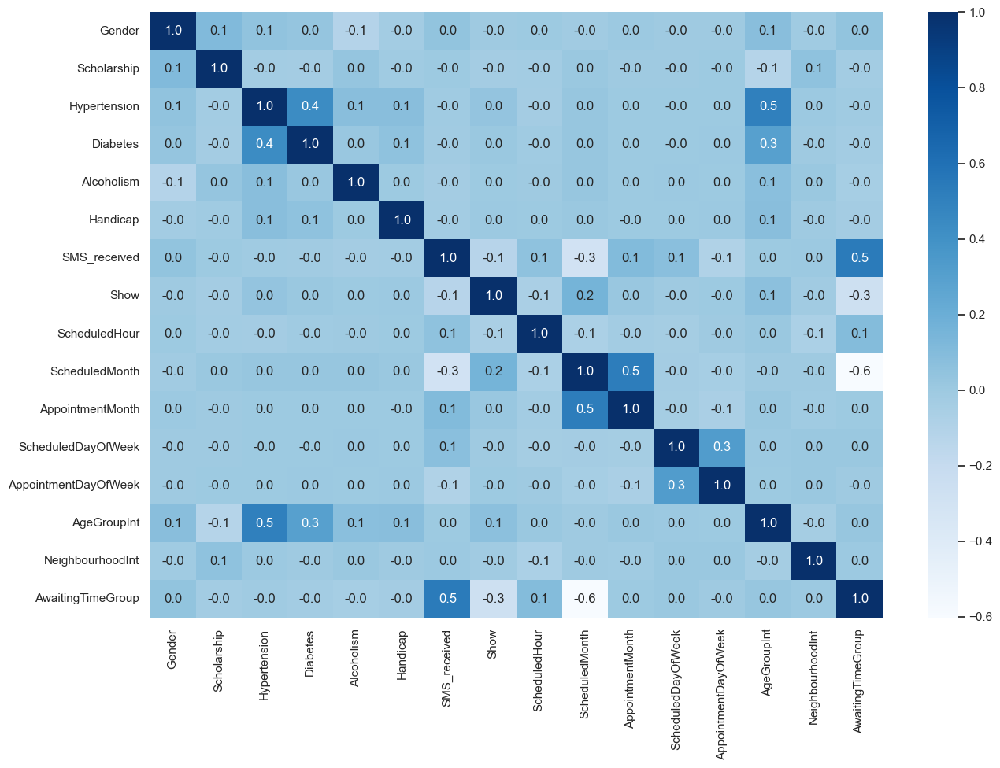

In [338]:
plt.figure(figsize=(15, 10))
sns.heatmap(df.corr(), annot=True, fmt='.1f', cmap='Blues')
plt.show()

### Drop columns that seem unimportant

In [341]:
df = df.drop(columns=['NeighbourhoodInt'])
df.head(5)

,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,AppointmentMonth,AppointmentDayOfWeek,AgeGroupInt,AwaitingTimeGroup
0,1,0,1,0,0,0,0,1,4,4,5,1
1,0,0,0,0,0,0,0,1,4,4,5,1
2,1,0,0,0,0,0,0,1,4,4,5,1
3,1,0,0,0,0,0,0,1,4,4,1,1
4,1,0,1,1,0,0,0,1,4,4,5,1


In [ ]:
df = df.drop(columns=['ScheduledHour', 'ScheduledDayOfWeek', 'ScheduledMonth'])
df.head(5)

In [343]:
df = df.drop(columns=['Scholarship'])
df.head(5)

,Gender,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,AppointmentMonth,AppointmentDayOfWeek,AgeGroupInt,AwaitingTimeGroup
0,1,1,0,0,0,0,1,4,4,5,1
1,0,0,0,0,0,0,1,4,4,5,1
2,1,0,0,0,0,0,1,4,4,5,1
3,1,0,0,0,0,0,1,4,4,1,1
4,1,1,1,0,0,0,1,4,4,5,1


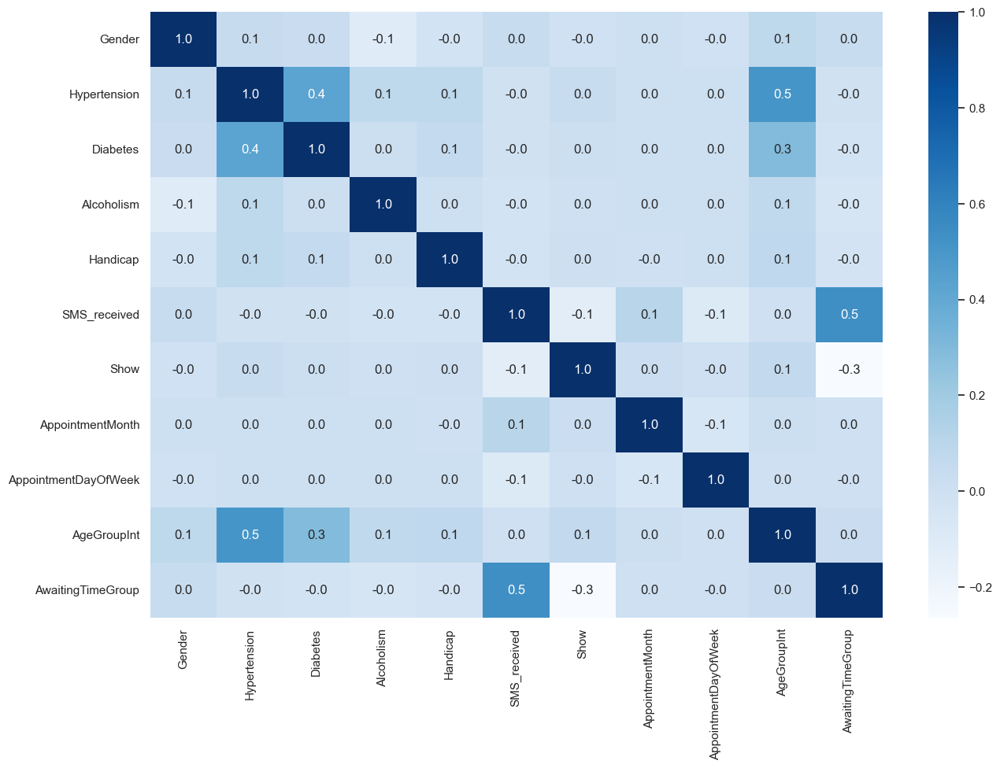

In [344]:
plt.figure(figsize=(15, 10))
sns.heatmap(df.corr(), annot=True, fmt='.1f', cmap='Blues')
plt.show()

In [345]:
df.to_csv('data/cleaned_data_general_final.csv', index=False)